In [1]:
import pandas as pd
import numpy as np


df = pd.read_csv('spotify_tracks.csv')
df.head()

#阅读表头
df.columns

Index(['track_id', 'track_name', 'artist_name', 'year', 'popularity',
       'artwork_url', 'album_name', 'acousticness', 'danceability',
       'duration_ms', 'energy', 'instrumentalness', 'key', 'liveness',
       'loudness', 'mode', 'speechiness', 'tempo', 'time_signature', 'valence',
       'track_url', 'language'],
      dtype='object')

<Axes: >

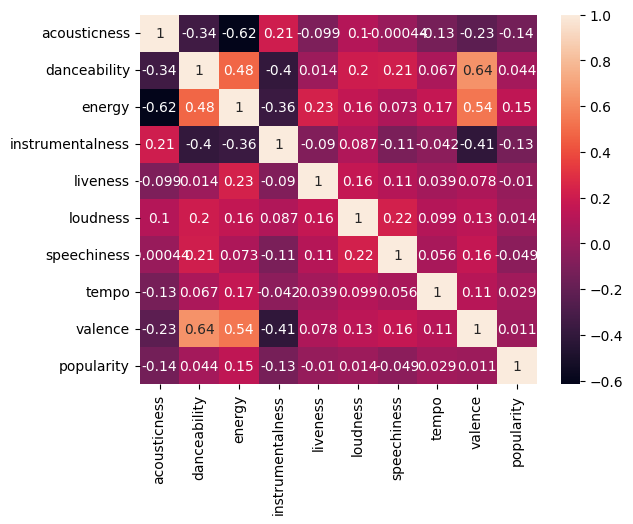

In [26]:
# 可以使用以下特征进行相关性分析
features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 
           'liveness', 'loudness', 'speechiness', 'tempo', 'valence','popularity']
# 使用seaborn的热力图
!pip install seaborn
import seaborn as sns
correlation = df[features].corr()
sns.heatmap(correlation, annot=True)

<Axes: xlabel='language', ylabel='popularity'>

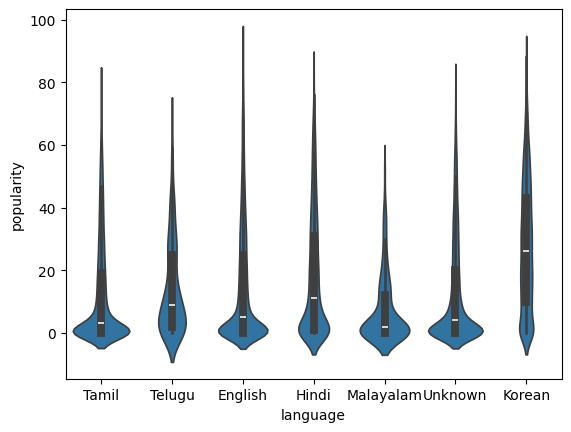

In [3]:
# 可以使用小提琴图展示不同特征的分布
sns.violinplot(data=df, y='popularity', x='language')

In [4]:
# 使用音乐特征进行聚类，然后可视化
!pip install scikit-learn


In [5]:
# 第一部分：准备数据
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# 获取每年最受欢迎的10首歌
def get_top_songs_by_year(df, n=10):
    return df.sort_values('popularity', ascending=False).groupby('year').head(n)

top_songs = get_top_songs_by_year(df, 10)

In [6]:
# 安装必要的包
!pip install --upgrade nbformat
!pip install --upgrade ipykernel

In [7]:
# 第二部分：创建散点图
features_to_plot = ['danceability', 'energy', 'valence', 'acousticness']
fig1 = px.scatter(top_songs, 
                 x='year', 
                 y='popularity',
                 size='popularity',
                 color='energy',
                 hover_data=['track_name', 'artist_name'] + features_to_plot,
                 title='Top Songs Distribution by Year')
fig1.show()

In [12]:
# 为不同特征创建散点图
features_to_analyze = ['danceability', 'tempo', 'instrumentalness', 'liveness']

for feature in features_to_analyze:
    fig = px.scatter(top_songs, 
                    x='year', 
                    y=feature,  # 纵坐标改为音乐特征
                    color='popularity',  # 颜色表示流行度
                    size='popularity',  # 保持大小表示流行度
                    hover_data=['track_name', 'artist_name', feature, 'popularity'],
                    title=f'{feature.capitalize()} of Top Songs by Year',
                    labels={feature: feature.capitalize()},
                    color_continuous_scale='viridis')  # 可以选择其他颜色方案
    
    # 更新布局
    fig.update_layout(
        xaxis_title="Year",
        yaxis_title=feature.capitalize(),
        coloraxis_colorbar_title="Popularity"
    )
    fig.show()

In [15]:
import plotly.express as px

# 使用完整数据集创建散点图
fig = px.scatter(
    df,
    x='instrumentalness',
    y='popularity',
    animation_frame='year',
    hover_data=['track_name', 'artist_name'],
    color='energy',
    size='popularity',
    title='Instrumentalness vs Popularity Over Years (All Songs)',
    labels={
        'instrumentalness': 'Instrumentalness',
        'popularity': 'Popularity',
        'energy': 'Energy'
    }
)

# 更新布局
fig.update_layout(
    xaxis_title="Instrumentalness",
    yaxis_title="Popularity",
    xaxis=dict(range=[0, 1]),  # 限制x轴范围为0-1
    height=600,
    width=800,
    showlegend=True
)

# 反转年份顺序
fig.layout.sliders[0].steps = fig.layout.sliders[0].steps[::-1]

# 更新动画设置
fig.update_traces(marker=dict(size=8))
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1000
fig.layout.updatemenus[0].buttons[0].args[1]['transition']['duration'] = 500

# 显示图表
fig.show()

In [17]:
import plotly.express as px

# 使用完整数据集创建散点图
fig = px.scatter(
    df,
    x='danceability',
    y='popularity',
    animation_frame='year',
    hover_data=['track_name', 'artist_name'],
    color='energy',
    size='popularity',
    title='Danceability vs Popularity Over Years (All Songs)',
    labels={
        'danceability': 'Danceability',
        'popularity': 'Popularity',
        'energy': 'Energy'
    }
)

# 更新布局
fig.update_layout(
    xaxis_title="Danceability",
    yaxis_title="Popularity",
    xaxis=dict(range=[0, 1]),  # 限制x轴范围为0-1
    height=600,
    width=800,
    showlegend=True
)

# 反转年份顺序
fig.layout.sliders[0].steps = fig.layout.sliders[0].steps[::-1]

# 更新动画设置
fig.update_traces(marker=dict(size=8))
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1000
fig.layout.updatemenus[0].buttons[0].args[1]['transition']['duration'] = 500

# 显示图表
fig.show()

In [19]:
import plotly.express as px

# 创建五年间隔的组
df['year_group'] = ((df['year'] // 5) * 5).astype(str) + '-' + (((df['year'] // 5) * 5 + 4)).astype(str)

# 使用完整数据集创建散点图
fig = px.scatter(
    df,
    x='danceability',
    y='popularity',
    animation_frame='year_group',  # 使用新创建的年份组
    hover_data=['track_name', 'artist_name', 'year'],  # 添加具体年份到悬停信息
    color='energy',
    size='popularity',
    title='Danceability vs Popularity Over Years (All Songs)',
    labels={
        'danceability': 'Danceability',
        'popularity': 'Popularity',
        'energy': 'Energy',
        'year_group': 'Year Period'
    }
)

# 更新布局
fig.update_layout(
    xaxis_title="Danceability",
    yaxis_title="Popularity",
    xaxis=dict(range=[0, 1]),  # 限制x轴范围为0-1
    height=600,
    width=800,
    showlegend=True
)

# 反转年份组顺序
fig.layout.sliders[0].steps = fig.layout.sliders[0].steps[::-1]

# 更新动画设置
fig.update_traces(marker=dict(size=8))
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1000
fig.layout.updatemenus[0].buttons[0].args[1]['transition']['duration'] = 500

# 显示图表
fig.show()

2015-2019 出现了很多 Danceability 和 Popularity 都很低的歌曲，这是反常的。


In [23]:
# 筛选2015-2019年间，energy和danceability都较低的歌曲
low_energy_dance = df[
    (df['year'].between(2015, 2019)) & 
    (df['energy'] < 0.4) & 
    (df['danceability'] < 0.4)
].sort_values(by=['energy', 'danceability'])[
    ['track_name', 'artist_name', 'year', 'energy', 'danceability', 'popularity']
]

# 按照 popularity 排序  
low_energy_dance = low_energy_dance.sort_values(by='popularity', ascending=False)
print(f"找到 {len(low_energy_dance)} 首符合条件的歌曲")

#写入csv
low_energy_dance.to_csv('low_energy_dance.csv', index=False)


找到 100 首符合条件的歌曲


Lo-fi 音乐大概在 2017 年左右开始变得热门，并通过 YouTube 上的直播等方式迅速传播开来。不过，Lo-fi 音乐的起源可以追溯到更早的时候。